# Problema de clasificación

# Análisis del Conjunto de Datos: Satisfacción de Clientes

## 1. Implementación de Modelos de Clasificación
- Utilizar la versión de clasificación para cada modelo estudiado en clases.
- Predecir la **variable respuesta** (última columna) y calcular las probabilidades para la **variable target**.
- Generar una **tabla de error** que contenga las siguientes métricas de clasificación:
    - Precision
    - Recall
    - F1-Score
    - AUC
- Agregar los siguientes elementos:
    - **Matriz de Confusión**: Utilizar `confusion_matrix`.
    - **Curvas ROC**: Utilizar `plot_roc`.
- Registrar los resultados en una **tabla de error** (similar a Tabla 1) que resuma cada métrica obtenida por modelo.

---

## 2. Descripción de las Variables
- Describir los **tipos de variables** en el conjunto de datos.
- Calcular:
    - Número total de observaciones.
    - Media, desviación estándar, mínimo, máximo y cuartiles de cada variable.
- Realizar un **conteo de datos faltantes** y calcular su porcentaje.
- Graficar:
    - **Histograma o diagrama de barras** para la variable respuesta e independientes (según corresponda).
    - Seleccionar un **mínimo de 10 variables independientes** para este análisis.

---

## 3. Análisis Univariado y Bivariado

### Univariado:
- Analizar simetría, datos atípicos y dispersión utilizando `boxplot()`.

### Bivariado:
- Graficar `scatterplot()` y `regplot()` para un mínimo de **10 pares de variables explicativas**.
- En cada figura, agregar un análisis y descripción.

---

## 4. Imputación y Reducción de Dimensionalidad

### Imputación de Datos:
- Realizar imputación de datos faltantes mediante **Imputación Iterativa Múltiple**.

### Reducción de Dimensionalidad:
- Identificar y eliminar columnas altamente correlacionadas utilizando el **Variance Inflation Factor (VIF)**.
    - Utilizar la función `variance_inflation_factor()`.
    - Un VIF ≥ 10 indica alta multicolinealidad.
- Procedimiento:
    - **Eliminar iterativamente**: En cada paso, eliminar la columna con el mayor VIF ≥ 10.
    - Recalcular el VIF en el nuevo conjunto de datos y repetir hasta que todas las variables tengan un VIF < 10.
- Justificar:
    - Documentar y justificar la eliminación de cada variable.
    - Proponer una **metodología alternativa** de reducción de dimensionalidad si se considera más pertinente.


## Instalación de librerías

Se realiza la instalación adecuada de librerías y paquetes para el análisis y modelación.

In [1]:
!pip install pandas numpy matplotlib seaborn scikit-learn scipy tabulate plotly


In [2]:
from google.colab import drive  # Import the drive module from google.colab
drive.mount('/content/drive')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import kurtosis, skew
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.subplots as sp
from plotly.graph_objs import Histogram
from tabulate import tabulate
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor
from scipy.stats import chi2_contingency
from sklearn.preprocessing import LabelEncoder
# from sklearn.metrics import roc_curve, auc, plot_roc_curve


Mounted at /content/drive


## Importación y tratamiento de datos

### Datos de train

Se importan los datos a utilizar en formato csv

In [3]:
filepath = ('/content/drive/My Drive/Parcial3/train.csv')
train = pd.read_csv(filepath)
train.head()

,ID,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,...,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38,TARGET
0,1,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39205.170000,0
1,3,2,34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49278.030000,0
2,4,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,67333.770000,0
3,8,2,37,0.0,195.0,195.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64007.970000,0
4,10,2,39,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117310.979016,0


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76020 entries, 0 to 76019
Columns: 371 entries, ID to TARGET
dtypes: float64(111), int64(260)
memory usage: 215.2 MB


El conjunto de datos de entrenamiento `train` tiene un total de 76.020 registros de satisfacción de clientes para 371 variables, incluidas la variable objetivo `TARGET` con categorías binarias para clasifición `0-1`.

In [ ]:
print(train.shape)

(76020, 371)


Se indaga sobre la naturaleza y variabilidad de los datos de entrenamiento de manera superficial. Inicialmente se realiza un conteo de valores únicos para cada columna y validar si existen valores diferentes o repetidos, lo que da pie a indicios de variables que no son de tipo numérico (entero) sino categórico.

In [ ]:

variable_types = []

for col in train.columns:
    var_type = train[col].dtype
    unique_count = train[col].nunique()
    value_counts = len(train[col])
    variable_types.append([col, var_type, unique_count, value_counts])


table = tabulate(variable_types, headers=['Variable Name', 'Type', 'Unique Values', 'Values Count'], tablefmt='grid')
print(table)


+-------------------------------+---------+-----------------+----------------+
| Variable Name                 | Type    |   Unique Values |   Values Count |
+===============================+=========+=================+================+
| ID                            | int64   |           76020 |          76020 |
+-------------------------------+---------+-----------------+----------------+
| var3                          | int64   |             208 |          76020 |
+-------------------------------+---------+-----------------+----------------+
| var15                         | int64   |             100 |          76020 |
+-------------------------------+---------+-----------------+----------------+
| imp_ent_var16_ult1            | float64 |             596 |          76020 |
+-------------------------------+---------+-----------------+----------------+
| imp_op_var39_comer_ult1       | float64 |            7551 |          76020 |
+-------------------------------+---------+---------

,count
int64,260
float64,111


El conjunto de datos de entrenamiento posee `260 variables enteras` y `111 variables flotantes`.

In [ ]:
type_counts = train.dtypes.value_counts().reset_index()
type_counts.columns = ['Type', 'Count']
print("\nVariable Types and Counts:")
type_counts


Variable Types and Counts:


,Type,Count
0,int64,260
1,float64,111


La vista de tabla para cada variable muestra cuales son los datos en cada registro y se observa un conteo de valores repetitivos para las variable de tipo entero (0, 1, 2,...) lo que podría sugerir que son categorías de elección y que cada tiene algún tipo de significado.

In [ ]:
print(tabulate(train.head(10), headers = 'keys', tablefmt='pretty'))

+---+------+------+-------+--------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------+-------------------------+-------------------------+-------------------+--------------------+------------+----------+------------+----------+------------+----------+------------+----------+------------+----------+-------------+-----------+-------------+-------------------+-----------------+-------------------+-----------------+-------------------+-----------------+-----------+-------------+-----------+-------------+-----------+-------------+-----------+-----------+-------------+-----------+-------------+-----------+---------------+-------------+---------------+-----------+-------------+-----------+-------------+-------------+-----------+-------

### Datos de test

Se carga y observa el conjunto de datos de entrenamiento con 370 variables exceptuando la variable a predecir 'TARGET'

In [ ]:
filepath = ('/content/drive/My Drive/Parcial3/test.csv')
test = pd.read_csv(filepath)
test.head()

,ID,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,...,saldo_medio_var29_ult3,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38
0,2,2,32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40532.10
1,5,2,35,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45486.72
2,6,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46993.95
3,7,2,24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,187898.61
4,9,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,73649.73


In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75818 entries, 0 to 75817
Columns: 370 entries, ID to var38
dtypes: float64(110), int64(260)
memory usage: 214.0 MB


In [ ]:
test.shape

(75818, 370)

Para analizar la distribución de los valores de cada variable del conjunto de test, se verifica cuantos valores son unicos y con ello observar indicios de categóricas.

En la tabla se puede observar que la diferencia entre el total de observaciones y el número único de registros en cada variable es abismal, lo que sugiere que la naturaleza de las variables se asimila a una categórica o estartificación.

In [ ]:
variable_types = []

for col in test.columns:
    var_type = test[col].dtype
    unique_count = test[col].nunique()
    value_counts = len(test[col])
    variable_types.append([col, var_type, unique_count, value_counts])


table = tabulate(variable_types, headers=['Variable Name', 'Type', 'Unique Values', 'Values Count'], tablefmt='grid')
print(table)

+-------------------------------+---------+-----------------+----------------+
| Variable Name                 | Type    |   Unique Values |   Values Count |
+===============================+=========+=================+================+
| ID                            | int64   |           75818 |          75818 |
+-------------------------------+---------+-----------------+----------------+
| var3                          | int64   |             199 |          75818 |
+-------------------------------+---------+-----------------+----------------+
| var15                         | int64   |             100 |          75818 |
+-------------------------------+---------+-----------------+----------------+
| imp_ent_var16_ult1            | float64 |             598 |          75818 |
+-------------------------------+---------+-----------------+----------------+
| imp_op_var39_comer_ult1       | float64 |            7593 |          75818 |
+-------------------------------+---------+---------

In [ ]:
type_counts = test.dtypes.value_counts().reset_index()
type_counts.columns = ['Type', 'Count']
print("\nVariable Types and Counts:")
type_counts


Variable Types and Counts:


,Type,Count
0,int64,260
1,float64,110


In [ ]:
print(tabulate(test.head(10), headers = 'keys', tablefmt='pretty'))

+---+------+------+-------+--------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------+-------------------------+-------------------------+-------------------------+-------------------------+-------------------+-------------------------+-------------------------+-------------------+--------------------+------------+----------+------------+----------+------------+----------+------------+----------+------------+----------+-------------+-----------+-------------+-------------------+-----------------+-------------------+-----------------+-------------------+-----------------+-----------+-------------+-----------+-------------+-----------+-------------+-----------+-----------+-------------+-----------+-------------+-----------+---------------+-------------+---------------+-----------+-------------+-----------+-------------+-------------+-----------+-------

### Comparación entre conjuntos de datos (train vs test)

Se desea comparar si las variables que están en el conjunto de datos de entrenamiento son las mismas del conjunto de test, se concluye que posee la misma longitud y que adicionalmente el conjunto de test no tiene '`TARGET`' ya que se predecirán con el modelo.

In [ ]:
filastrain = len(train)
filastest = len(test)
columnastrain= len(train.columns)
columnastest= len(test.columns)
print(f'Los datos de train tiene {filastrain} filas y {columnastrain} columnas')
print(f'Los datos de test tiene {filastest} filas y {columnastest} columnas')

Los datos de train tiene 76020 filas y 371 columnas
Los datos de test tiene 75818 filas y 370 columnas


Al comparar si tienen las mimas variables, se concluye que si poseen las mismas variables y un número de registros similar.

In [ ]:
train_cols = set(train.columns)
test_cols = set(test.columns)

# Check for columns only in train
only_in_train = train_cols - test_cols
if only_in_train:
    print("Columns only in train dataset:")
    for col in only_in_train:
        print(col)

# Check for columns only in test
only_in_test = test_cols - train_cols
if only_in_test:
    print("\nColumns only in test dataset:")
    for col in only_in_test:
        print(col)

# Check if all columns in test are present in train
if train_cols.issuperset(test_cols):
    print("\nAll columns in test are present in train.")
else:
    print("\nNot all columns in test are present in train.")

Columns only in train dataset:
TARGET

All columns in test are present in train.


# Análisis Exploratorio de los Datos

## Datos de entrenamiento

***Convertir la variable `Target` en categórica***

In [ ]:
train['TARGET'] = train['TARGET'].astype('category')
print(train['TARGET'])

0        0
1        0
2        0
3        0
4        0
        ..
76015    0
76016    0
76017    0
76018    0
76019    0
Name: TARGET, Length: 76020, dtype: category
Categories (2, int64): [0, 1]


### Verificamos datos faltantes

`Datos Faltantes (Missing Count):`


- `Cero (0):` En todas las variables de la tabla, el número de valores faltantes es cero, lo que significa que no hay datos faltantes en ninguna de las variables.
- Todas las variables en la tabla tienen un "`Missing Count" de 0`, lo que indica que no se necesita realizar ningún tratamiento de datos faltantes, ya que todas las variables están completas.

`Datos Ceros (Zero Count):`
- Muchas de las variables tienen un gran número de ceros (con valores cercanos a 0 para un gran porcentaje de los registros), lo que podría indicar que estas variables contienen un número considerable de valores que son cero y de ser categóricas.
- Algunas variables tienen más de 99% de ceros, lo que sugiere que podrían ser variables que en su mayoría están vacías o no registran información en la mayoría de los registros. Por ejemplo:
Variables como `imp_op_var39_comer_ult1`, `imp_op_var40_comer_ult3` tienen un 99.99% de ceros.
- Variables como `imp_op_var39_efect_ult3` tienen un 99.9974% de ceros.
Otras variables tienen una proporción más baja de ceros, como `imp_op_var40_comer_ult1`, que tiene un porcentaje de ceros más bajo en comparación con otras variables (99.98%).

In [ ]:
missing_data_summary = pd.DataFrame({
    'Missing Count': train.isnull().sum(),
    'Missing Percentage': (train.isnull().sum() / len(train)) * 100,
    'Zero Count': (train == 0).sum(),
    'Zero Percentage': (train == 0).sum() / len(train) * 100
}).T

missing_data_table = tabulate(
    missing_data_summary,
    headers=missing_data_summary.columns,
    tablefmt='grid'
)

# Display the table
print(missing_data_table)

+--------------------+------+------------+---------+----------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------+---------------------------+---------------------------+---------------------+----------------------+--------------+------------+--------------+------------+--------------+------------+--------------+------------+--------------+------------+---------------+-------------+---------------+---------------------+-------------------+---------------------+-------------------+---------------------+-------------------+-------------+---------------+-------------+---------------+-------------+---------------+-------------+-------------+---------------+-------------+---------------+-------------+----------

Ninguna de las variables del conjunto de datos posee observaciones o datos faltantes, por lo que la matriz de datos faltantes indica que ninguna de las variable tiene observaciones faltantes.

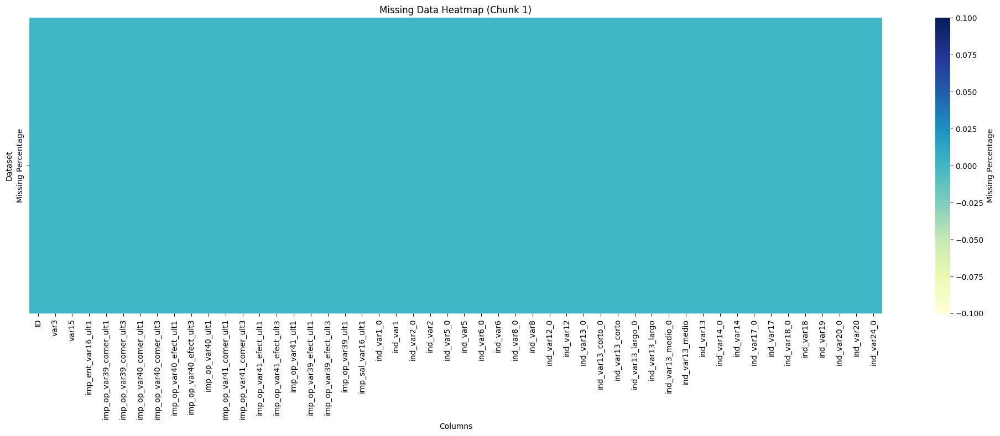

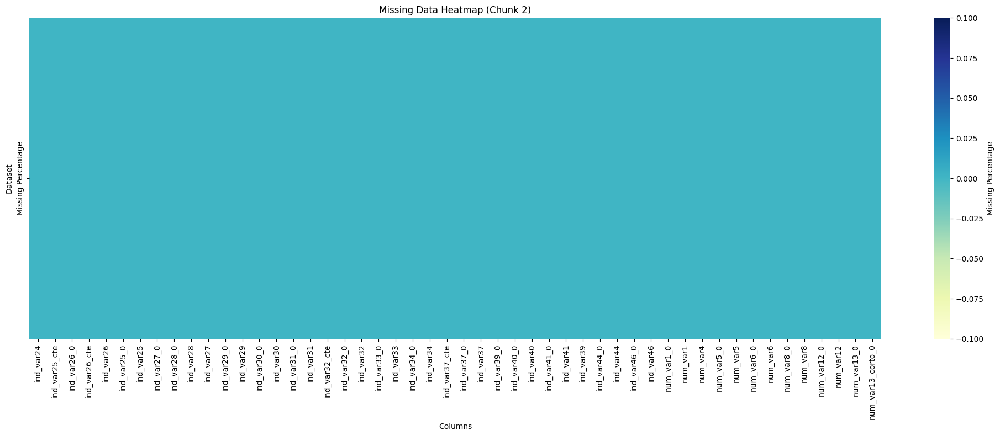

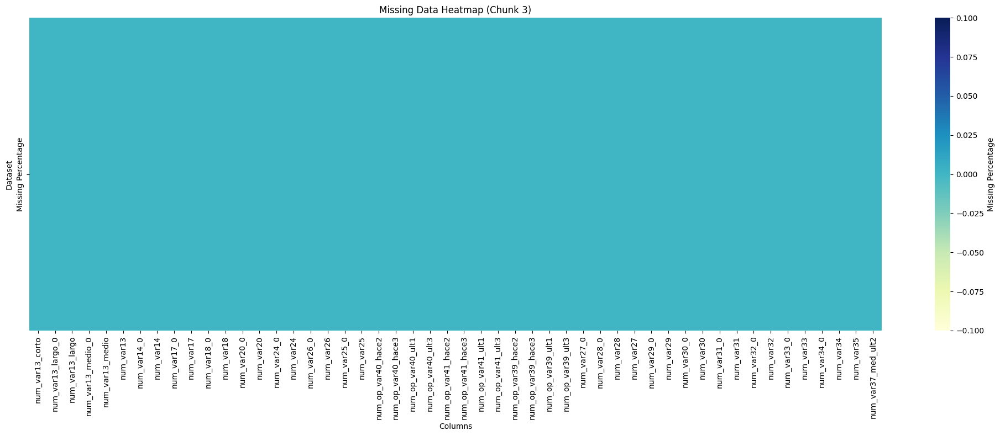

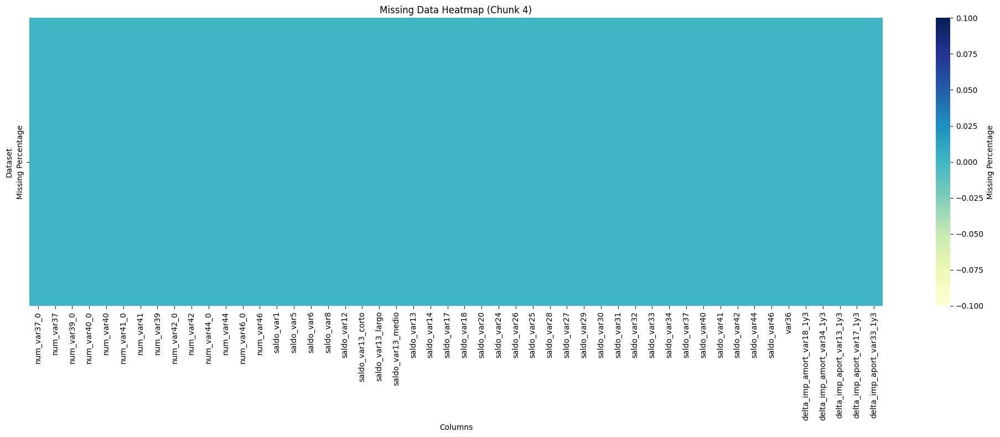

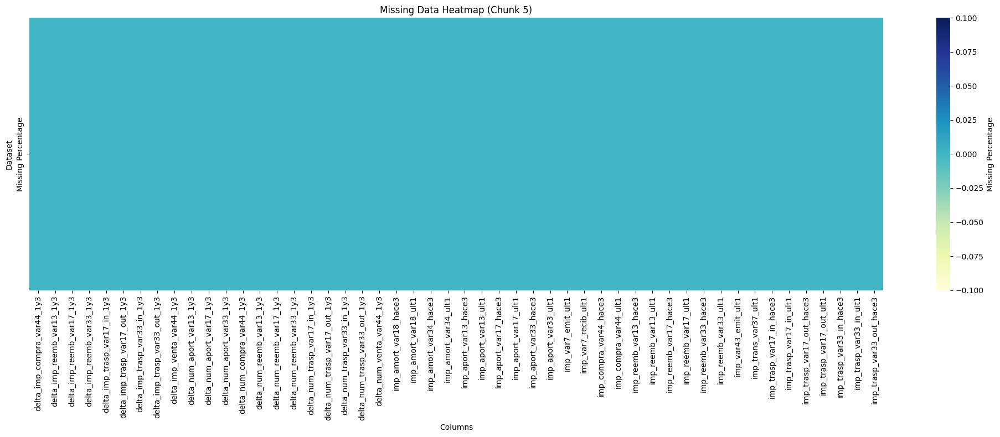

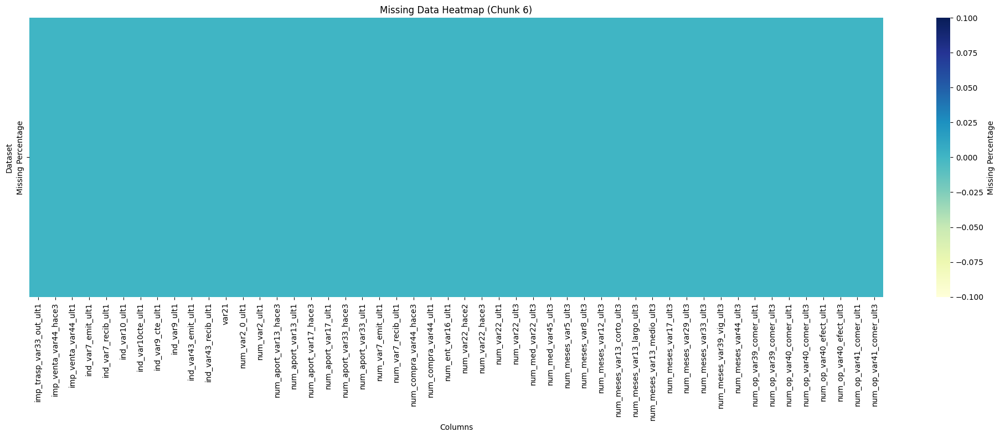

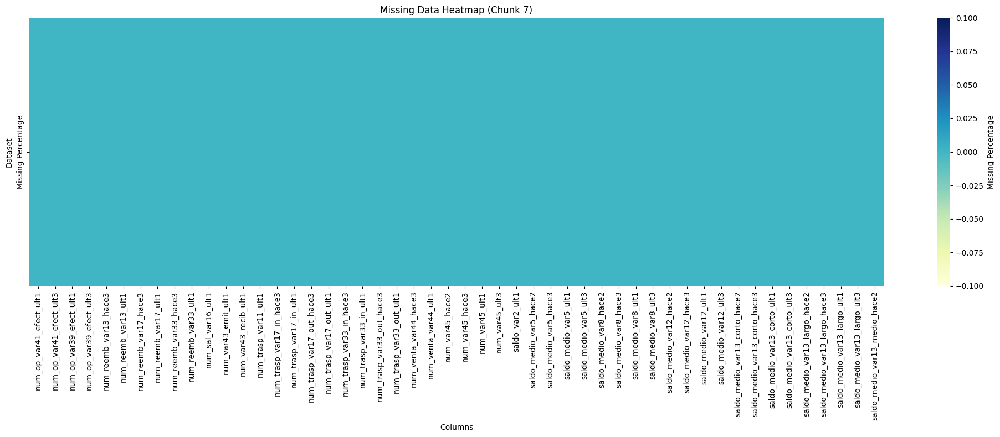

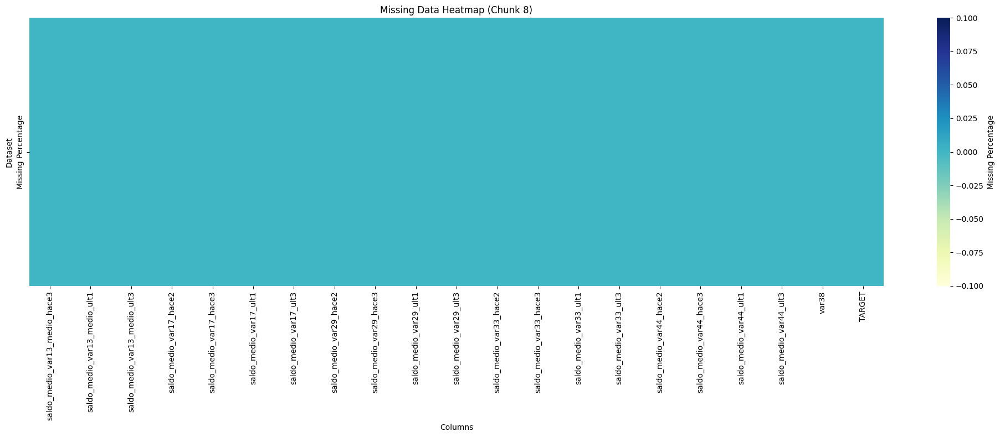

In [ ]:
missing_percentage = train.isnull().mean() * 100

missing_data_df = pd.DataFrame({
    'Missing Percentage': missing_percentage
})

chunk_size = 50
columns = missing_data_df.index.tolist()
chunks = [columns[i:i + chunk_size] for i in range(0, len(columns), chunk_size)]

for i, chunk in enumerate(chunks):
    plt.figure(figsize=(20, 8))
    sns.heatmap(missing_data_df.loc[chunk].T, annot=False, fmt=".2f", cmap="YlGnBu", cbar_kws={'label': 'Missing Percentage'})
    plt.title(f"Missing Data Heatmap (Chunk {i + 1})")
    plt.xlabel("Columns")
    plt.ylabel("Dataset")
    plt.xticks(rotation=90)  # Rotate x-axis labels for better visibility
    plt.tight_layout()
    plt.show()

### Verificamos tipos de variables

Teniendo en cuenta a alta cantidad y proporción de datos en cero de las variables, se podría considerar esas variables como categóricas codificadas como enteras, procedemos a **verificar si las variables enteras pueden ser potenciales variables categóricas**.

En este caso, algunas variables como ind_var1, ind_var2, ind_var5, num_var1_0, entre otras, probablemente se comportan como variables categóricas debido a la presencia de un número limitado de valores distintos, que pueden indicar categorías como "`presente`" o "`ausente`" (por ejemplo, 0 o 1).

Por otro lado, las variables que contienen una distribución más continua o una variedad más amplia de valores, como algunas de las que están relacionadas con valores monetarios, transacciones o variables de tipo númerico flotante, como `imp_op_var39_comer_ult1` o `imp_op_var40_comer_ult1`, no parecen ser categóricas.

In [ ]:
integer_columns = train.select_dtypes(include=['int'])

categorical_check = pd.DataFrame({
    'Variable': integer_columns.columns,
    'Data Type': integer_columns.dtypes,
    'Unique Values': integer_columns.nunique(),
    'Total Rows': len(train),
    'Is Potentially Categorical': integer_columns.apply(lambda col: col.nunique() < 0.05 * len(train))
})

from tabulate import tabulate
result_table = tabulate(
    categorical_check,
    headers=['Variable', 'Data Type', 'Unique Values', 'Total Rows', 'Is Potentially Categorical'],
    tablefmt='grid'
)
print(result_table)


+-------------------------------+-------------------------------+-------------+-----------------+--------------+------------------------------+
|                               | Variable                      | Data Type   |   Unique Values |   Total Rows | Is Potentially Categorical   |
+===============================+===============================+=============+=================+==============+==============================+
| ID                            | ID                            | int64       |           76020 |        76020 | False                        |
+-------------------------------+-------------------------------+-------------+-----------------+--------------+------------------------------+
| var3                          | var3                          | int64       |             208 |        76020 | True                         |
+-------------------------------+-------------------------------+-------------+-----------------+--------------+------------------------

**Analizamos las variables que poseen menos de 10 valores enteros únicos**.

El análisis sugiere que un número considerable de variables podrían clasificarse como categóricas, dada su alta frecuencia de ceros o valores constantes y su poca variedas, es decir en un rango normal de `0 - 1` o `0 - 9`.

In [ ]:
# Filter columns with less than 10 unique values
filtered_columns = integer_columns.loc[:, integer_columns.nunique() <= 10]

# Display the filtered DataFrame
from tabulate import tabulate
result_table = tabulate(
    filtered_columns.head(),  # Display the first few rows of the filtered data
    headers='keys',
    tablefmt='grid'
)
print(f"Filtered DataFrame contains {filtered_columns.shape[1]} columns with less than 10 unique values.")
print(result_table)


Filtered DataFrame contains 212 columns with less than 10 unique values.
+----+--------------+------------+--------------+------------+--------------+------------+--------------+------------+--------------+------------+---------------+-------------+---------------+---------------------+-------------------+---------------------+-------------------+---------------------+-------------------+-------------+---------------+-------------+---------------+-------------+---------------+-------------+-------------+---------------+-------------+---------------+-------------+-----------------+---------------+-----------------+-------------+---------------+-------------+---------------+---------------+-------------+-------------+---------------+-------------+---------------+-------------+---------------+-------------+-----------------+---------------+-------------+---------------+-------------+---------------+-------------+-----------------+---------------+-------------+---------------+-------------

Las variables con menos de 10 valores unicos para las 76mil observaciones son 212.

In [ ]:
filtered_column_count = filtered_columns.shape[1]
print(f"Número de variables con menos de 11 valores únicos : {filtered_column_count}")

Número de variables con menos de 11 valores únicos : 212


In [ ]:
unique_values_dict = {col: filtered_columns[col].unique() for col in filtered_columns.columns}

unique_values_df = pd.DataFrame({
    'Variable': list(unique_values_dict.keys()),
    'Unique Values': [list(unique_values_dict[col]) for col in unique_values_dict.keys()]
})

from tabulate import tabulate
result_table = tabulate(
    unique_values_df,
    headers=['Variable', 'Unique Values'],
    tablefmt='grid'
)
print(result_table)


+-----+-------------------------------+--------------------------------------+
|     | Variable                      | Unique Values                        |
+=====+===============================+======================================+
|   0 | ind_var1_0                    | [0, 1]                               |
+-----+-------------------------------+--------------------------------------+
|   1 | ind_var1                      | [0, 1]                               |
+-----+-------------------------------+--------------------------------------+
|   2 | ind_var2_0                    | [0]                                  |
+-----+-------------------------------+--------------------------------------+
|   3 | ind_var2                      | [0]                                  |
+-----+-------------------------------+--------------------------------------+
|   4 | ind_var5_0                    | [1, 0]                               |
+-----+-------------------------------+-------------

**Analizamos las variables que tienen más de 10 valores únicos y menos o igual a 100**

También se observa un patrón repetitivo en los valores de estas variables, de 3 en 3 o valoes en concreto, estas suman 44.

In [ ]:
filtered_columns = integer_columns.loc[:, (integer_columns.nunique() > 10) & (integer_columns.nunique() <= 100)]

from tabulate import tabulate
result_table = tabulate(
    filtered_columns.head(),
    headers='keys',
    tablefmt='grid'
)
print(f"Filtered DataFrame contains {filtered_columns.shape[1]} columns with less than 10 unique values.")
print(result_table)

Filtered DataFrame contains 44 columns with less than 10 unique values.
+----+---------+---------------+----------------------+---------------------+---------------------+----------------------+----------------------+---------------------+---------------------+----------------------+----------------------+---------------------+---------------------+---------------+---------------+-------------+----------------------+---------------+-------------+-------------------------+---------+----------------------+-------------------+-------------------+------------------+------------------+----------------------+----------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+---------------------------+-----------------------+------------------------+------------------------+-------------

In [ ]:
filtered_column_count = filtered_columns.shape[1]
print(f"Número de variables con más de 10 y menos de 101 valores únicos : {filtered_column_count}")

Número de variables con más de 10 y menos de 101 valores únicos : 44


Muchas variables tienen valores que parecen estar en escalas discretas y controladas, como múltiplos de números enteros pequeños (por ejemplo, 3, 6, 9) o valores derivados de cálculos específicos.
Esto puede indicar que representan conteos, frecuencias o alguna forma de clasificación ordinal numérica.

In [ ]:
unique_values_dict = {col: filtered_columns[col].unique() for col in filtered_columns.columns}

unique_values_df = pd.DataFrame({
    'Variable': list(unique_values_dict.keys()),
    'Unique Values': [list(unique_values_dict[col]) for col in unique_values_dict.keys()]
})

from tabulate import tabulate
result_table = tabulate(
    unique_values_df,
    headers=['Variable', 'Unique Values'],
    tablefmt='grid'
)
print(result_table)

+----+-------------------------+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|    | Variable                | Unique Values                                                                                                                                                                                                                                                                                                                                                                                                                                                             |
+====+========

**Tranformamos a categóricas y verificamos nuevamente los tipos de datos**

De las 371 variables del conjunto de entrenamiento se realizan las siguientes transformaciones:
1. `Int --> Object:` se transforman 259/260-
2. Se mantienen 111 de las 111
3. Int se mantiene 1 sola equivalente a `ID`

In [ ]:
filtered_int_columns = train.select_dtypes(include=['int64']).loc[:, train.nunique() < 500]

# Transformar esas variables a tipo object (no numéricas)
for col in filtered_int_columns.columns:
    train[col] = train[col].astype('object')

# Verificar las transformaciones
print(f"Se transformaron {len(filtered_int_columns.columns)} columnas a tipo 'object'.")
print("Columnas transformadas:")
print(filtered_int_columns.columns.tolist())


Se transformaron 259 columnas a tipo 'object'.
Columnas transformadas:
['var3', 'var15', 'ind_var1_0', 'ind_var1', 'ind_var2_0', 'ind_var2', 'ind_var5_0', 'ind_var5', 'ind_var6_0', 'ind_var6', 'ind_var8_0', 'ind_var8', 'ind_var12_0', 'ind_var12', 'ind_var13_0', 'ind_var13_corto_0', 'ind_var13_corto', 'ind_var13_largo_0', 'ind_var13_largo', 'ind_var13_medio_0', 'ind_var13_medio', 'ind_var13', 'ind_var14_0', 'ind_var14', 'ind_var17_0', 'ind_var17', 'ind_var18_0', 'ind_var18', 'ind_var19', 'ind_var20_0', 'ind_var20', 'ind_var24_0', 'ind_var24', 'ind_var25_cte', 'ind_var26_0', 'ind_var26_cte', 'ind_var26', 'ind_var25_0', 'ind_var25', 'ind_var27_0', 'ind_var28_0', 'ind_var28', 'ind_var27', 'ind_var29_0', 'ind_var29', 'ind_var30_0', 'ind_var30', 'ind_var31_0', 'ind_var31', 'ind_var32_cte', 'ind_var32_0', 'ind_var32', 'ind_var33_0', 'ind_var33', 'ind_var34_0', 'ind_var34', 'ind_var37_cte', 'ind_var37_0', 'ind_var37', 'ind_var39_0', 'ind_var40_0', 'ind_var40', 'ind_var41_0', 'ind_var41', 'ind_

In [ ]:
type_counts = train.dtypes.value_counts().reset_index()
type_counts.columns = ['Type', 'Count']
print("\nVariable Types and Counts:")
type_counts


Variable Types and Counts:


,Type,Count
0,object,259
1,float64,111
2,int64,1


### Verificamos multicolinealidad

El proceso para eliminar multicolinealidad utilizando el VIF (Variance Inflation Factor) implica calcular el VIF para cada variable, el cual mide cuánto se incrementa la varianza de los coeficientes debido a la colinealidad. Si el VIF de una variable es mayor o igual a 10, indica alta multicolinealidad, por lo que se elimina. Este procedimiento se realiza de manera iterativa, eliminando en cada paso la variable con el mayor VIF, hasta que todas las variables restantes tengan un VIF inferior a 10. Durante cada iteración, se muestra el Top 10 de variables con mayor VIF y las variables eliminadas.

In [ ]:
# Filtrar las variables de tipo float
float_columns = train.select_dtypes(include=['float64']).columns
float_data = train[float_columns]

# Eliminar columnas con varianza cero
float_data = float_data.loc[:, float_data.var() > 0]

# Función para calcular VIF
def calculate_vif(dataframe):
    vif_data = pd.DataFrame()
    vif_data['Variable'] = dataframe.columns
    vif_data['VIF'] = [
        variance_inflation_factor(dataframe.values, i)
        for i in range(dataframe.shape[1])
    ]
    return vif_data

In [ ]:
# Iterar eliminando variables con VIF >= 10
while True:
    vif = calculate_vif(float_data)
    print("Top 10 variables with highest VIF:")
    print(vif.sort_values(by="VIF", ascending=False).head(10))

    # Encontrar la variable con mayor VIF
    max_vif = vif['VIF'].max()
    if max_vif < 10:
        print("No variables with VIF >= 10. Process complete.")
        break

    # Eliminar la variable con mayor VIF
    variable_to_remove = vif.sort_values(by="VIF", ascending=False).iloc[0]['Variable']
    float_data = float_data.drop(columns=[variable_to_remove])

    print(f"Variable removed: {variable_to_remove}\n")

/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                        Variable  VIF
45     delta_num_aport_var13_1y3  inf
48    delta_num_compra_var44_1y3  inf
35                   saldo_var33  inf
19                    saldo_var6  inf
42     delta_imp_aport_var33_1y3  inf
31                   saldo_var29  inf
46     delta_num_aport_var17_1y3  inf
47     delta_num_aport_var33_1y3  inf
27                   saldo_var20  inf
93  saldo_medio_var13_medio_ult3  inf
Variable removed: delta_num_aport_var13_1y3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
46      delta_num_aport_var33_1y3  inf
19                     saldo_var6  inf
91  saldo_medio_var13_medio_hace2  inf
47     delta_num_compra_var44_1y3  inf
27                    saldo_var20  inf
31                    saldo_var29  inf
92   saldo_medio_var13_medio_ult3  inf
6         imp_op_var40_efect_ult3  inf
42      delta_imp_aport_var33_1y3  inf
43     delta_imp_compra_var44_1y3  inf
Variable removed: delta_num_aport_var33_1y3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
45      delta_num_aport_var17_1y3  inf
90  saldo_medio_var13_medio_hace2  inf
19                     saldo_var6  inf
43     delta_imp_compra_var44_1y3  inf
44      delta_imp_venta_var44_1y3  inf
31                    saldo_var29  inf
27                    saldo_var20  inf
41      delta_imp_aport_var17_1y3  inf
91   saldo_medio_var13_medio_ult3  inf
46     delta_num_compra_var44_1y3  inf
Variable removed: delta_num_aport_var17_1y3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
33                    saldo_var31  inf
89  saldo_medio_var13_medio_hace2  inf
45     delta_num_compra_var44_1y3  inf
43     delta_imp_compra_var44_1y3  inf
35                    saldo_var33  inf
5         imp_op_var40_efect_ult1  inf
19                     saldo_var6  inf
90   saldo_medio_var13_medio_ult3  inf
31                    saldo_var29  inf
24                    saldo_var13  inf
Variable removed: saldo_var31



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
24                    saldo_var13  inf
27                    saldo_var20  inf
23              saldo_var13_largo  inf
19                     saldo_var6  inf
89   saldo_medio_var13_medio_ult3  inf
42     delta_imp_compra_var44_1y3  inf
88  saldo_medio_var13_medio_hace2  inf
22              saldo_var13_corto  inf
10        imp_op_var41_efect_ult1  inf
31                    saldo_var29  inf
Variable removed: saldo_var13



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
32                    saldo_var32  inf
14        imp_op_var39_efect_ult3  inf
43     delta_num_compra_var44_1y3  inf
88   saldo_medio_var13_medio_ult3  inf
87  saldo_medio_var13_medio_hace2  inf
30                    saldo_var29  inf
26                    saldo_var20  inf
24                    saldo_var14  inf
19                     saldo_var6  inf
41     delta_imp_compra_var44_1y3  inf
Variable removed: saldo_var32



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable           VIF
19                     saldo_var6           inf
30                    saldo_var29           inf
40     delta_imp_compra_var44_1y3           inf
26                    saldo_var20           inf
86  saldo_medio_var13_medio_hace2           inf
87   saldo_medio_var13_medio_ult3           inf
23              saldo_var13_largo           inf
42     delta_num_compra_var44_1y3           inf
6         imp_op_var40_efect_ult3  9.007199e+15
5         imp_op_var40_efect_ult1  9.007199e+15
Variable removed: saldo_var6



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
11        imp_op_var41_efect_ult3  inf
23                    saldo_var14  inf
41     delta_num_compra_var44_1y3  inf
29                    saldo_var29  inf
25                    saldo_var20  inf
39     delta_imp_compra_var44_1y3  inf
6         imp_op_var40_efect_ult3  inf
86   saldo_medio_var13_medio_ult3  inf
1         imp_op_var39_comer_ult1  inf
85  saldo_medio_var13_medio_hace2  inf
Variable removed: imp_op_var41_efect_ult3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable  VIF
24                    saldo_var20  inf
85   saldo_medio_var13_medio_ult3  inf
22                    saldo_var14  inf
21              saldo_var13_largo  inf
5         imp_op_var40_efect_ult1  inf
20              saldo_var13_corto  inf
38     delta_imp_compra_var44_1y3  inf
28                    saldo_var29  inf
40     delta_num_compra_var44_1y3  inf
84  saldo_medio_var13_medio_hace2  inf
Variable removed: saldo_var20



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                         Variable           VIF
20              saldo_var13_corto           inf
12        imp_op_var39_efect_ult1           inf
37     delta_imp_compra_var44_1y3           inf
84   saldo_medio_var13_medio_ult3           inf
27                    saldo_var29           inf
83  saldo_medio_var13_medio_hace2           inf
21              saldo_var13_largo           inf
39     delta_num_compra_var44_1y3           inf
2         imp_op_var39_comer_ult3           inf
4         imp_op_var40_comer_ult3  9.007199e+15
Variable removed: saldo_var13_corto



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                      Variable           VIF
38  delta_num_compra_var44_1y3           inf
36  delta_imp_compra_var44_1y3           inf
5      imp_op_var40_efect_ult1           inf
26                 saldo_var29           inf
10     imp_op_var41_efect_ult1  9.007199e+15
3      imp_op_var40_comer_ult1  4.503600e+15
31                 saldo_var42  4.503600e+15
7            imp_op_var40_ult1  1.125900e+15
19                 saldo_var12  7.505999e+14
12     imp_op_var39_efect_ult1  2.370316e+14
Variable removed: delta_num_compra_var44_1y3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                     Variable  VIF
1     imp_op_var39_comer_ult1  inf
10    imp_op_var41_efect_ult1  inf
19                saldo_var12  inf
18                 saldo_var8  inf
17                 saldo_var5  inf
14          imp_op_var39_ult1  inf
26                saldo_var29  inf
12    imp_op_var39_efect_ult1  inf
37  delta_imp_venta_var44_1y3  inf
11          imp_op_var41_ult1  inf
Variable removed: imp_op_var39_comer_ult1



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                     Variable  VIF
37  delta_num_venta_var44_1y3  inf
10          imp_op_var41_ult1  inf
30                saldo_var42  inf
25                saldo_var29  inf
1     imp_op_var39_comer_ult3  inf
18                saldo_var12  inf
17                 saldo_var8  inf
13          imp_op_var39_ult1  inf
36  delta_imp_venta_var44_1y3  inf
11    imp_op_var39_efect_ult1  inf
Variable removed: delta_num_venta_var44_1y3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                   Variable  VIF
30              saldo_var42  inf
9   imp_op_var41_efect_ult1  inf
18              saldo_var12  inf
17               saldo_var8  inf
16               saldo_var5  inf
13        imp_op_var39_ult1  inf
11  imp_op_var39_efect_ult1  inf
10        imp_op_var41_ult1  inf
25              saldo_var29  inf
8   imp_op_var41_comer_ult3  inf
Variable removed: saldo_var42



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                   Variable         VIF
9   imp_op_var41_efect_ult1         inf
11  imp_op_var39_efect_ult1         inf
3   imp_op_var40_comer_ult3         inf
4   imp_op_var40_efect_ult1         inf
13        imp_op_var39_ult1         inf
6         imp_op_var40_ult1         inf
1   imp_op_var39_comer_ult3         inf
8   imp_op_var41_comer_ult3         inf
10        imp_op_var41_ult1         inf
15               saldo_var1  2587.72883
Variable removed: imp_op_var41_efect_ult1



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                   Variable          VIF
1   imp_op_var39_comer_ult3          inf
6         imp_op_var40_ult1          inf
12        imp_op_var39_ult1          inf
8   imp_op_var41_comer_ult3          inf
9         imp_op_var41_ult1          inf
3   imp_op_var40_comer_ult3          inf
14               saldo_var1  2587.728830
35     imp_amort_var18_ult1  2586.465924
89   saldo_medio_var33_ult1  1798.946886
26              saldo_var33  1702.214798
Variable removed: imp_op_var39_comer_ult3



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Top 10 variables with highest VIF:
                  Variable          VIF
8        imp_op_var41_ult1          inf
5        imp_op_var40_ult1          inf
11       imp_op_var39_ult1          inf
13              saldo_var1  2587.728830
34    imp_amort_var18_ult1  2586.465924
88  saldo_medio_var33_ult1  1798.946886
25             saldo_var33  1702.214798
19             saldo_var17  1240.830260
80  saldo_medio_var17_ult1   803.053795
38   imp_aport_var17_hace3   714.725201
Variable removed: imp_op_var41_ult1

Top 10 variables with highest VIF:
                  Variable          VIF
12              saldo_var1  2587.728830
33    imp_amort_var18_ult1  2586.465924
87  saldo_medio_var33_ult1  1798.946886
24             saldo_var33  1702.214798
18             saldo_var17  1240.830260
79  saldo_medio_var17_ult1   803.053795
37   imp_aport_var17_hace3   714.725201
15             saldo_var12   683.175814
80  saldo_medio_var17_ult3   642.017302
23             saldo_var30   423.949132
Variable remo

Finalmente se obtiene la lista de variables que quedan posterior a la eliminación de columnas con alta multicolinealidad.

In [ ]:
# Obtener las variables restantes en el dataframe 'float_data' después de la eliminación de las variables con alto VIF
remaining_variables_after_vif = float_data.columns.tolist()

# Imprimir las variables que quedaron después de la eliminación por VIF
print("Variables que quedaron después del VIF:")
print(remaining_variables_after_vif)

Variables que quedaron después del VIF:
['imp_ent_var16_ult1', 'imp_op_var40_comer_ult1', 'imp_op_var40_comer_ult3', 'imp_op_var40_efect_ult1', 'imp_op_var40_efect_ult3', 'imp_op_var40_ult1', 'imp_op_var41_comer_ult1', 'imp_op_var41_comer_ult3', 'imp_op_var39_efect_ult1', 'imp_op_var39_efect_ult3', 'imp_sal_var16_ult1', 'saldo_var5', 'saldo_var8', 'saldo_var13_largo', 'saldo_var14', 'saldo_var25', 'saldo_var29', 'saldo_var33', 'saldo_var37', 'saldo_var40', 'saldo_var44', 'delta_imp_aport_var13_1y3', 'delta_imp_aport_var17_1y3', 'delta_imp_aport_var33_1y3', 'delta_imp_compra_var44_1y3', 'delta_imp_venta_var44_1y3', 'imp_amort_var18_ult1', 'imp_amort_var34_ult1', 'imp_aport_var13_hace3', 'imp_aport_var13_ult1', 'imp_aport_var17_ult1', 'imp_var7_emit_ult1', 'imp_var7_recib_ult1', 'imp_compra_var44_hace3', 'imp_reemb_var13_ult1', 'imp_reemb_var17_hace3', 'imp_reemb_var17_ult1', 'imp_var43_emit_ult1', 'imp_trans_var37_ult1', 'imp_trasp_var17_in_hace3', 'imp_trasp_var17_in_ult1', 'imp_trasp_

**Matriz de correlacion**


La gráfica de correlación muestra una alta correlación positiva entre varias variables numéricas, especialmente en aquellos grupos relacionados con transacciones, saldos y aportes. Esto sugiere que muchas de las variables pueden estar capturando patrones similares de información.

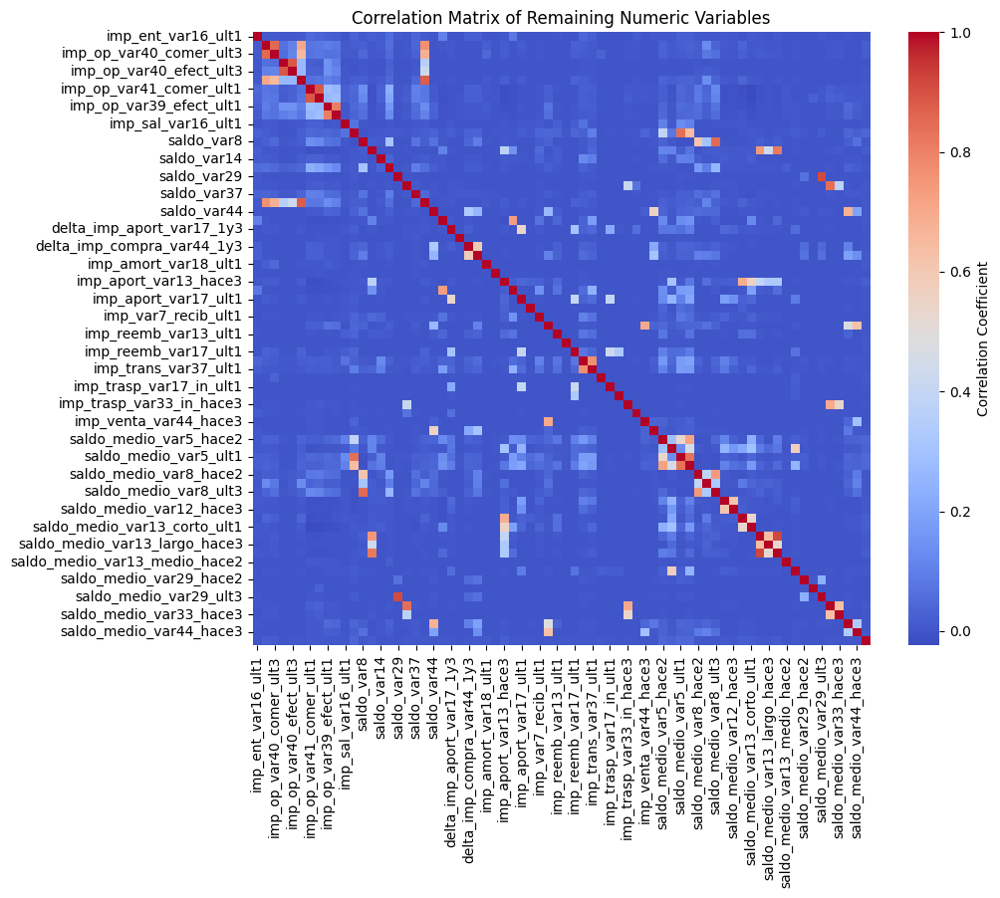

In [ ]:
numerical_data = train[remaining_variables_after_vif]  # Usamos las variables restantes después del VIF

# Calculamos la matriz de correlación
correlation_matrix = numerical_data.corr()

# Mostramos la matriz de correlación con un heatmap sin anotaciones numéricas
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=False, cmap="coolwarm", cbar_kws={'label': 'Correlation Coefficient'})
plt.title('Correlation Matrix of Remaining Numeric Variables')
plt.show()

### Verificar multicolinealidad entre categóricas

**Hipótesis de la prueba de Chi-cuadrado:**

- **Hipótesis nula** $H_0$: No hay asociación entre las variables categóricas. Es decir, las variables son independientes entre sí.
- **Hipótesis alternativa** $H_1$: Existe una asociación entre las variables categóricas. Es decir, las variables no son independientes entre sí.

La prueba de Chi-cuadrado se utiliza para evaluar si las diferencias observadas entre las frecuencias de una tabla de contingencia son estadísticamente significativas.

In [ ]:
# Filtrar las variables categóricas u objetos
categorical_columns = train.select_dtypes(include=['object']).columns
categorical_data = train[categorical_columns]

In [ ]:
# Función para calcular la prueba chi-cuadrado
def chi_square_test(data, target):
    chi2_results = {}
    for column in data.columns:
        # Crear una tabla de contingencia
        contingency_table = pd.crosstab(data[column], target)
        # Calcular el estadístico de chi-cuadrado
        chi2, p, _, _ = chi2_contingency(contingency_table)
        chi2_results[column] = p  # Guardamos el valor p de la prueba
    return chi2_results


In [ ]:
# Realizar la prueba de chi-cuadrado para las variables categóricas
chi2_results = chi_square_test(categorical_data, train['TARGET'])

# Mostrar los resultados de la prueba
print("Chi-square p-values for categorical variables:")
for column, p_value in chi2_results.items():
    print(f"{column}: p-value = {p_value}")

# Eliminar variables con p-value >= 0.05 (no significativas)
columns_to_remove = [column for column, p_value in chi2_results.items() if p_value >= 0.05]
print("\nVariables to remove due to lack of significance (p-value >= 0.05):")
print(columns_to_remove)

# Eliminar las variables irrelevantes
train_cleaned = train.drop(columns=columns_to_remove)

# Comprobamos las variables que quedaron
print("\nVariables remaining after removal:")
print(train_cleaned.columns.tolist())

Chi-square p-values for categorical variables:
var3: p-value = 1.0
var15: p-value = 2.479050748575357e-300
ind_var1_0: p-value = 0.7219194087113513
ind_var1: p-value = 0.012885600454086847
ind_var2_0: p-value = 1.0
ind_var2: p-value = 1.0
ind_var5_0: p-value = 1.8580886418147953e-19
ind_var5: p-value = 1.7534870866437744e-304
ind_var6_0: p-value = 1.0
ind_var6: p-value = 1.0
ind_var8_0: p-value = 1.363996333540147e-37
ind_var8: p-value = 2.107791944905891e-14
ind_var12_0: p-value = 8.689041671854727e-26
ind_var12: p-value = 5.4587615851313735e-21
ind_var13_0: p-value = 2.2019183820487882e-27
ind_var13_corto_0: p-value = 4.453919713126134e-21
ind_var13_corto: p-value = 3.4360481470866676e-21
ind_var13_largo_0: p-value = 1.9029930279518028e-07
ind_var13_largo: p-value = 2.5190424880955373e-07
ind_var13_medio_0: p-value = 1.0
ind_var13_medio: p-value = 1.0
ind_var13: p-value = 1.4458983480592337e-27
ind_var14_0: p-value = 4.606228518121834e-08
ind_var14: p-value = 0.05642237104167639
ind_

In [ ]:
# Realizar la prueba de chi-cuadrado para las variables categóricas y la variable objetivo 'TARGET'
def chi_square_test(categorical_data, target):
    chi2_results = {}
    for column in categorical_data.columns:
        contingency_table = pd.crosstab(categorical_data[column], target)
        chi2, p_value, _, _ = chi2_contingency(contingency_table)
        chi2_results[column] = p_value
    return chi2_results

# Realizar la prueba de chi-cuadrado
chi2_results = chi_square_test(categorical_data, train['TARGET'])

# Filtrar las variables categóricas con p-value < 0.05
significant_columns = [column for column, p_value in chi2_results.items() if p_value < 0.05]

# Filtrar las variables significativas para la variable objetivo 'TARGET'
categorical_data_significant = categorical_data[significant_columns]
train_with_target = pd.concat([categorical_data_significant, train['TARGET']], axis=1)

# Crear una matriz de correlación utilizando la estadística de chi-cuadrado
# Primero, convertimos la variable TARGET a categorías
train_with_target['TARGET'] = train_with_target['TARGET'].astype('category')


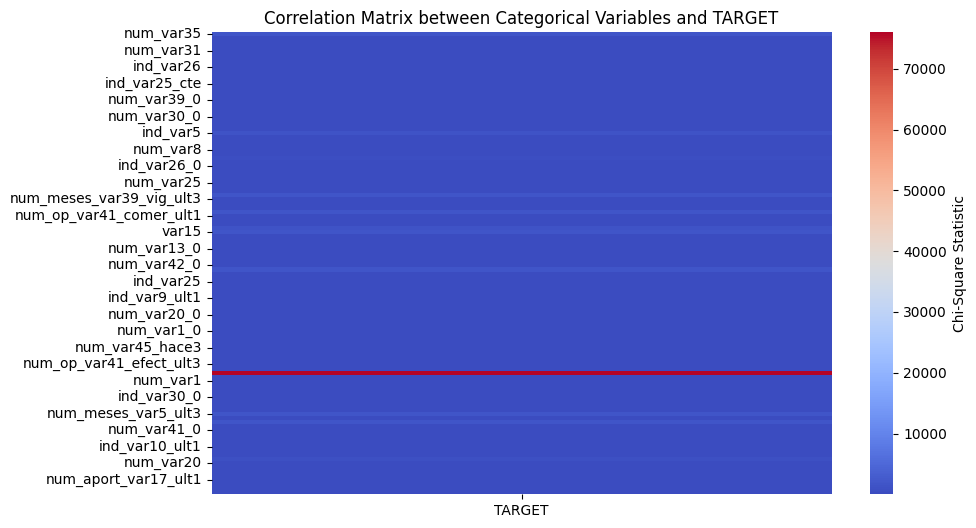

In [ ]:
correlation_matrix = pd.DataFrame(index=significant_columns, columns=['TARGET'])
for column in significant_columns:
    contingency_table = pd.crosstab(train_with_target[column].iloc[:, 0] if train_with_target[column].ndim > 1 else train_with_target[column],
                                     train_with_target['TARGET'].iloc[:, 0] if train_with_target['TARGET'].ndim > 1 else train_with_target['TARGET'])
    chi2, p_value, _, _ = chi2_contingency(contingency_table)
    correlation_matrix.loc[column, 'TARGET'] = chi2

correlation_matrix['TARGET'] = pd.to_numeric(correlation_matrix['TARGET'])

plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=False, cmap="coolwarm", cbar_kws={'label': 'Chi-Square Statistic'})  # Set annot=False
plt.title('Correlation Matrix between Categorical Variables and TARGET')
plt.show()


#### Filtramos el conjunto de datos original para tener las variables categóricas y numericas en la data a modelar

In [ ]:
# Variables numéricas restantes después del análisis VIF
numerical_data = train[remaining_variables_after_vif]
remaining_categorical_variables = list(set(categorical_columns) - set(columns_to_remove))

# Variables categóricas restantes después del análisis Chi-cuadrado
categorical_data = train[remaining_categorical_variables]
train_cleaned_combined = pd.concat([numerical_data, categorical_data], axis=1)

print("\nVariables remaining after combining numeric and categorical variables:")
print(train_cleaned_combined.columns.tolist())


Variables remaining after combining numeric and categorical variables:
['imp_ent_var16_ult1', 'imp_op_var40_comer_ult1', 'imp_op_var40_comer_ult3', 'imp_op_var40_efect_ult1', 'imp_op_var40_efect_ult3', 'imp_op_var40_ult1', 'imp_op_var41_comer_ult1', 'imp_op_var41_comer_ult3', 'imp_op_var39_efect_ult1', 'imp_op_var39_efect_ult3', 'imp_sal_var16_ult1', 'saldo_var5', 'saldo_var8', 'saldo_var13_largo', 'saldo_var14', 'saldo_var25', 'saldo_var29', 'saldo_var33', 'saldo_var37', 'saldo_var40', 'saldo_var44', 'delta_imp_aport_var13_1y3', 'delta_imp_aport_var17_1y3', 'delta_imp_aport_var33_1y3', 'delta_imp_compra_var44_1y3', 'delta_imp_venta_var44_1y3', 'imp_amort_var18_ult1', 'imp_amort_var34_ult1', 'imp_aport_var13_hace3', 'imp_aport_var13_ult1', 'imp_aport_var17_ult1', 'imp_var7_emit_ult1', 'imp_var7_recib_ult1', 'imp_compra_var44_hace3', 'imp_reemb_var13_ult1', 'imp_reemb_var17_hace3', 'imp_reemb_var17_ult1', 'imp_var43_emit_ult1', 'imp_trans_var37_ult1', 'imp_trasp_var17_in_hace3', 'imp_t

In [ ]:
train_cleaned_combined.shape

(76020, 182)

In [ ]:
type_counts = train_cleaned_combined.dtypes.value_counts().reset_index()
type_counts.columns = ['Type', 'Count']
print("\nVariable Types and Counts:")
type_counts


Variable Types and Counts:


,Type,Count
0,object,112
1,float64,70


### Análisis descriptivo

### Variable objetivo

Se desea observar el conteo o distribución de la variable objetivo 'TARGET', por lo que a través de un diagrama de pie se interpreta que el 96% de las observaciones pertenecen a la categoría 0 (no positiva), mientras que solo el
 3.96% pertenecen a la categoría 1 (positiva). Esto indica un fuerte desbalance en las clases, con una amplia mayoría en la clase 0, lo que podría requerir técnicas de balanceo como oversampling de la clase minoritaria o undersampling de la clase mayoritaria.

In [ ]:
fig = make_subplots(rows=1, cols=2,
                    subplot_titles=('Conteo de categorías de TARGET', 'Proporción de categorías de TARGET'),
                    specs=[[{"type": "xy"}, {"type": "domain"}]]) # Define subplot types

# Gráfico de barras (Bar Plot)
fig.add_trace(
    go.Bar(
        x=train['TARGET'].value_counts().index,
        y=train['TARGET'].value_counts().values,
        marker=dict(color='lightblue'),
        name='Bar Plot'
    ),
    row=1, col=1
)

# Gráfico de pastel (Pie Chart)
fig.add_trace(
    go.Pie(
        labels=train['TARGET'].value_counts().index,
        values=train['TARGET'].value_counts().values,
        name='Pie Chart',
        hole=0.3  # Hacer un gráfico de pastel con un agujero en el medio
    ),
    row=1, col=2
)

# Actualizar los títulos y etiquetas
fig.update_layout(
    title_text="Distribución de TARGET",
    showlegend=True,
    height=500,
    width=1000,
)

# Mostrar el gráfico
fig.show()

### Variables continuas

#### Análisis Descriptivos

El análisis estadístico revela comportamientos destacados en varias variables:

`imp_ent_var16_ult1`:

- Media: 86.2, Mediana: 0.
Alta dispersión (Desviación Estándar: 1614.76) y curtosis extrema (6321.02), sugiriendo valores atípicos significativos.

`saldo_var5`:

- Media: 1028.47, Mediana: 3, Rango Intercuartílico: 90.
Distribución sesgada con alta asimetría (26.98), indicando valores elevados concentrados en pocos casos.

`imp_op_var40_efect_ult1`:

- Media: 0.41, Mediana: 0, Desviación Estándar: 30.6.
Curtosis extremadamente alta (29,336.8) y asimetría (149.52), reflejando una gran concentración de valores nulos con algunos extremos.

`var38`:

- Media: 117,236, Mediana: 106,409.
Muy alta dispersión (Desviación Estándar: 182,665, Varianza: 3.33e+10), pero menos sesgada que otras variables (Asimetría: 51.27).

`delta_imp_aport_var13_1y3`:

- Media: 4.87e+07, Mediana: 0.
Altísima dispersión (Desviación Estándar: 6.96e+08) y curtosis elevada (200.46), indicando valores extremos recurrentes.

`saldo_var29`:

- Media: 0.41, Mediana: 0.
Desviación Estándar: 83.09 con curtosis elevada (45,822.1), lo que sugiere un comportamiento altamente disperso con valores extremos.

`saldo_medio_var5_hace2`:

- Media: 1579.14, Mediana: 3, Rango Intercuartílico: 90.
Alta dispersión y curtosis elevada (863.22), mostrando outliers significativos.

Estas variables presentan un fuerte desbalance, alta dispersión y concentración en valores nulos, acompañados de valores extremos.

1. **Asimetría**:

La mayoría de las variables presentan asimetrías positivas extremas, lo que indica distribuciones sesgadas hacia la derecha.
Ejemplos notables incluyen:
- `imp_op_var40_efect_ult1` (149.52): Valores extremadamente altos concentrados en pocos casos.
- `saldo_var29` (210.19): Fuerte sesgo con valores altos raros.
- `imp_amort_var18_ult1` (270.33): Sesgo extremo hacia valores altos.

Algunas variables tienen asimetrías más moderadas, como var38 (51.27), aunque sigue mostrando un sesgo considerable.



In [ ]:
numerical_data = train_cleaned_combined.select_dtypes(include=['float64'])

# Calcular estadísticas descriptivas
summary_stats = pd.DataFrame()

summary_stats['Media'] = numerical_data.mean()
summary_stats['Mediana'] = numerical_data.median()
summary_stats['Desviación Estándar'] = numerical_data.std()
summary_stats['Varianza'] = numerical_data.var()
summary_stats['Rango Intercuartílico (RIQ)'] = numerical_data.quantile(0.75) - numerical_data.quantile(0.25)
summary_stats['Curtosis'] = numerical_data.apply(kurtosis)
summary_stats['Asimetría'] = numerical_data.apply(skew)

# Mostrar la tabla con tabulate
print(tabulate(summary_stats, headers='keys', tablefmt='grid', showindex=True))

+-------------------------------+------------------+-----------+-----------------------+------------------+-------------------------------+------------+-------------+
|                               |            Media |   Mediana |   Desviación Estándar |         Varianza |   Rango Intercuartílico (RIQ) |   Curtosis |   Asimetría |
+===============================+==================+===========+=======================+==================+===============================+============+=============+
| imp_ent_var16_ult1            |     86.2083      |      0    |        1614.76        |      2.60744e+06 |                        0      |  6321.02   |    67.2662  |
+-------------------------------+------------------+-----------+-----------------------+------------------+-------------------------------+------------+-------------+
| imp_op_var40_comer_ult1       |      3.55913     |      0    |          93.1557      |   8677.99        |                        0      |  2787.5    |    45.8336  

#### Análisis Univariado

1. **Desbalance en las distribuciones:** La mayoría de las variables presentan distribuciones con sesgo positivo, confirmando que una pequeña proporción de valores elevados domina frente a la gran cantidad de observaciones bajas.
2. **Concentración de valores cercanos a cero:** La mayoría de las variables tienen distribuciones altamente sesgadas, con valores mayoritariamente concentrados cerca de cero (eje y con conteos elevados en estos rangos). Ejemplos notables incluyen `imp_ent_var16_ult1`, `imp_op_var40_comer_ult1`, y `imp_op_var40_efect_ult1`.

In [ ]:
floating_columns = train_cleaned_combined.select_dtypes(include=['float64']).columns[:10]
fig = sp.make_subplots(rows=2, cols=5, subplot_titles=floating_columns)

for i, column in enumerate(floating_columns):
    row = i // 5 + 1
    col = i % 5 + 1

    hist = Histogram(x=train_cleaned_combined[column], nbinsx=20, name=column)
    fig.add_trace(hist, row=row, col=col)

fig.update_layout(
    height=800,  # Ajustar el tamaño
    width=1000,
    title_text="Distribución de las Primeras 10 Variables Flotantes",
    showlegend=False,
    title_x=0.5,
    title_y=0.98,
    font=dict(size=12),  # Reducir tamaño de la fuente
    margin=dict(t=50, b=50, l=50, r=50)  # Añadir márgenes
)

for i in range(len(fig.layout.annotations)):
    fig.layout.annotations[i].font.size = 10


fig.update_xaxes(tickangle=-45, showticklabels=True) # Aplicar showticklabels y tickangle al eje X
fig.update_yaxes(showticklabels=True) # Aplicar showticklabels al eje Y


# Mostrar el gráfico
fig.show()

1. **Distribuciones altamente concentradas en valores bajos:** La mayoría de las variables, como `imp_ent_var16_ult1`, `imp_op_var40_comer_ult1` y `imp_op_var40_efect_ult1`, presentan distribuciones donde más del 95% de los datos se encuentran en valores cercanos a cero, lo que sugiere un comportamiento sesgado y desbalanceado.

2. **Valores extremos y dispersión:** Algunas variables, como `imp_op_var41_comer_ult1` y `imp_op_var39_efect_ult3`, muestran la presencia de valores extremos, lo que incrementa la dispersión y provoca colas largas en las distribuciones.

In [ ]:
import plotly.graph_objects as go
import plotly.subplots as sp

floating_columns_2 = train_cleaned_combined.select_dtypes(include=['float64']).columns[10:20]

subplot_titles = [
    f"<b>{col}</b>"  # Using HTML for bolding
    for col in floating_columns_2
]

fig = sp.make_subplots(rows=2, cols=5, subplot_titles=subplot_titles)
for i, column in enumerate(floating_columns_2):
    row = i // 5 + 1
    col = i % 5 + 1
    box_plot = go.Box(y=train_cleaned_combined[column], name=column)
    fig.add_trace(box_plot, row=row, col=col)

fig.update_layout(
    height=800,  # Ajustar el tamaño
    width=1000,
    title_text="Diagrama de Cajas y Bigotes de las Variables Flotantes",
    showlegend=False,
    title_x=0.5,
    title_y=0.98,
    font=dict(size=12),  # Reducir tamaño de la fuente
    margin=dict(t=50, b=50, l=50, r=50),  # Añadir márgenes
)

fig.update_xaxes(showticklabels=True, tickangle=-45)
fig.update_yaxes(showticklabels=True, tickangle=0)

for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=10)
fig.show()

1. **Densidad de valores bajos:** La mayoría de las variables, como `imp_ent_var16_ult1` y `imp_op_var40_comer_ult1`, muestran un alto número de observaciones cercanas a 0. Esto indica que estas variables tienen poca variabilidad en la mayor parte de los datos.

2. **Presencia de valores atípicos**: Varias variables, como `imp_op_var41_comer_ult1` y `imp_op_var39_efect_ult3`, exhiben valores extremos que no están dentro del rango típico de la distribución. Estos valores pueden tener un impacto significativo en métricas como la media y la varianza.

In [ ]:
floating_columns_3 = train_cleaned_combined.select_dtypes(include=['float64']).columns[20:30]
fig = sp.make_subplots(rows=2, cols=5, subplot_titles=floating_columns_3)

for i, column in enumerate(floating_columns_3):
    row = i // 5 + 1
    col = i % 5 + 1

    violin_plot = go.Violin(y=train_cleaned_combined[column], box_visible=True, line_color='purple', name=column)
    fig.add_trace(violin_plot, row=row, col=col)
    fig.update_xaxes(showticklabels=True, tickangle=-45, row=row, col=col)  # Mostrar y rotar etiquetas del eje X
    fig.update_yaxes(showticklabels=True, row=row, col=col)  # Mostrar etiquetas del eje Y


fig.update_layout(
    height=800,  # Ajustar el tamaño
    width=1000,
    title_text="Diagrama de Violín de las Variables Flotantes",
    showlegend=False,
    title_x=0.5,
    title_y=0.98,
    font=dict(size=12),  # Reducir tamaño de la fuente
    margin=dict(t=50, b=50, l=50, r=50)  # Añadir márgenes
)


for i in range(len(floating_columns_3)):
    fig.layout.annotations[i].update(font_size=10)
fig.show()

1. **Distribución Sesgada**

- La mayoría de las variables presentan una distribución altamente sesgada hacia valores cercanos a 0.
- Esto sugiere que los valores mayores a 0 son casos atípicos o representan un subconjunto específico de los datos.

2. **Pocos Valores Grandes**

- Algunas variables tienen valores extremos que alcanzan cifras muy altas (por ejemplo, en el rango de cientos de miles o millones).

In [ ]:
floating_columns_4 = train_cleaned_combined.select_dtypes(include=['float64']).columns[30:40]
fig = sp.make_subplots(rows=2, cols=5, subplot_titles=floating_columns_4)

for i, column in enumerate(floating_columns_4):
    row = i // 5 + 1
    col = i % 5 + 1


    density_plot = go.Histogram(
        x=train_cleaned_combined[column],
        histnorm='density',
        name=column,
        nbinsx=50,
        opacity=0.7,
        marker_color='lightblue',  # Color de relleno de las barras
        marker_line_color='blue',  # Color del borde de las barras
        marker_line_width=1       # Ancho del borde de las barras
    )

    fig.add_trace(density_plot, row=row, col=col)

fig.update_layout(
    height=800,  # Ajustar el tamaño
    width=1000,
    title_text="Diagrama de Densidad de las Variables Flotantes",
    showlegend=False,
    title_x=0.5,
    title_y=0.98,
    font=dict(size=12),  # Reducir tamaño de la fuente
    margin=dict(t=50, b=50, l=50, r=50)  # Añadir márgenes
)
fig.update_xaxes(showticklabels=True, tickangle=-45)
fig.update_yaxes(showticklabels=True, tickangle=0)


for annotation in fig['layout']['annotations']:
    annotation['font'] = dict(size=10)
fig.show()

#### Análisis bivariado

In [4]:
variables = ['imp_ent_var16_ult1', 'imp_op_var40_comer_ult1', 'imp_op_var40_comer_ult3', 'imp_op_var40_efect_ult1', 'imp_op_var40_efect_ult3', 'imp_op_var40_ult1', 'imp_op_var41_comer_ult1', 'imp_op_var41_comer_ult3', 'imp_op_var39_efect_ult1', 'imp_op_var39_efect_ult3', 'imp_sal_var16_ult1', 'saldo_var5', 'saldo_var8', 'saldo_var13_largo', 'saldo_var14', 'saldo_var25', 'saldo_var29', 'saldo_var33', 'saldo_var37', 'saldo_var40', 'saldo_var44', 'delta_imp_aport_var13_1y3', 'delta_imp_aport_var17_1y3', 'delta_imp_aport_var33_1y3', 'delta_imp_compra_var44_1y3', 'delta_imp_venta_var44_1y3', 'imp_amort_var18_ult1', 'imp_amort_var34_ult1', 'imp_aport_var13_hace3', 'imp_aport_var13_ult1', 'imp_aport_var17_ult1', 'imp_var7_emit_ult1', 'imp_var7_recib_ult1', 'imp_compra_var44_hace3', 'imp_reemb_var13_ult1', 'imp_reemb_var17_hace3', 'imp_reemb_var17_ult1', 'imp_var43_emit_ult1', 'imp_trans_var37_ult1', 'imp_trasp_var17_in_hace3', 'imp_trasp_var17_in_ult1', 'imp_trasp_var17_out_ult1', 'imp_trasp_var33_in_hace3', 'imp_trasp_var33_in_ult1', 'imp_venta_var44_hace3', 'imp_venta_var44_ult1', 'saldo_medio_var5_hace2', 'saldo_medio_var5_hace3', 'saldo_medio_var5_ult1', 'saldo_medio_var5_ult3', 'saldo_medio_var8_hace2', 'saldo_medio_var8_hace3', 'saldo_medio_var8_ult3', 'saldo_medio_var12_hace2', 'saldo_medio_var12_hace3', 'saldo_medio_var13_corto_hace3', 'saldo_medio_var13_corto_ult1', 'saldo_medio_var13_largo_hace2', 'saldo_medio_var13_largo_hace3', 'saldo_medio_var13_largo_ult1', 'saldo_medio_var13_medio_hace2', 'saldo_medio_var17_ult1', 'saldo_medio_var29_hace2', 'saldo_medio_var29_hace3', 'saldo_medio_var29_ult3', 'saldo_medio_var33_hace2', 'saldo_medio_var33_hace3', 'saldo_medio_var44_hace2', 'saldo_medio_var44_hace3', 'var38', 'num_var35', 'ind_var41_0', 'num_var13_corto', 'num_op_var41_ult1', 'num_var31', 'ind_var43_recib_ult1', 'num_var22_ult1', 'num_reemb_var17_ult1', 'ind_var26', 'num_var24_0', 'num_op_var41_efect_ult1', 'ind_var8', 'ind_var25_cte', 'num_var8_0', 'ind_var20', 'num_var26_0', 'num_var39_0', 'ind_var39_0', 'num_var17_0', 'num_var14_0', 'num_var30_0', 'ind_var40', 'num_var13_corto_0', 'num_meses_var13_largo_ult3', 'ind_var5', 'num_var39', 'num_meses_var12_ult3', 'num_var25_0', 'num_var8', 'num_meses_var8_ult3', 'num_var45_ult3', 'num_op_var39_efect_ult1', 'ind_var26_0', 'ind_var25_0', 'ind_var26_cte', 'num_aport_var13_hace3', 'num_var25', 'num_var13_largo', 'ind_var24_0', 'num_var4', 'num_meses_var39_vig_ult3', 'num_var22_hace2', 'var21', 'ind_var30', 'num_op_var41_comer_ult1', 'num_var12_0', 'ind_var24', 'num_var5', 'var15', 'num_op_var39_ult3', 'ind_var8_0', 'num_op_var39_efect_ult3', 'num_var13_0', 'ind_var13_0', 'num_var45_ult1', 'ind_var1', 'num_var42_0', 'num_var30', 'ind_var31', 'ind_var9_cte_ult1', 'ind_var25', 'ind_var13_largo_0', 'ind_var20_0', 'ind_var12_0', 'ind_var9_ult1', 'num_med_var45_ult3', 'num_var31_0', 'num_var45_hace2', 'num_var20_0', 'ind_var10cte_ult1', 'num_var13_largo_0', 'ind_var39', 'num_var1_0', 'num_op_var39_ult1', 'num_op_var40_efect_ult1', 'num_var13', 'num_var45_hace3', 'num_op_var40_efect_ult3', 'ind_var12', 'num_var40_0', 'num_op_var41_efect_ult3', 'num_var5_0', 'TARGET', 'num_var22_ult3', 'num_var1', 'num_op_var41_ult3', 'num_var40', 'ind_var31_0', 'ind_var30_0', 'ind_var13_corto', 'ind_var19', 'num_var22_hace3', 'num_meses_var5_ult3', 'ind_var13_corto_0', 'num_var42', 'ind_var13', 'num_var41_0', 'ind_var13_largo', 'ind_var14_0', 'num_var26', 'ind_var10_ult1', 'num_meses_var13_corto_ult3', 'num_var12', 'var36', 'num_var20', 'num_med_var22_ult3', 'num_var24', 'num_var43_emit_ult1', 'num_aport_var17_ult1', 'num_var37_med_ult2', 'num_op_var39_comer_ult1', 'ind_var5_0']

In [7]:
train_cleaned_combined = train[variables]  # Conjunto de entrenamiento (contiene 'TARGET')
# Contar las variables de tipo numérico (flotante) y categórico (objeto)
numeric_vars = train_cleaned_combined.select_dtypes(include=['float64', 'int64']).columns
categorical_vars = train_cleaned_combined.select_dtypes(include=['category', 'object']).columns

# Mostrar el número de variables de cada tipo
print(f'Número de variables numéricas: {len(numeric_vars)}')
print(f'Número de variables categóricas: {len(categorical_vars)}')

Número de variables numéricas: 182
Número de variables categóricas: 0


In [8]:
type_counts = train_cleaned_combined.dtypes.value_counts().reset_index()
type_counts.columns = ['Type', 'Count']
print("\nVariable Types and Counts:")
type_counts


Variable Types and Counts:


,Type,Count
0,int64,112
1,float64,70


**Correlaciones numéricas**

Aunque hay puntos dispersos, no parece haber una relación lineal clara entre las variables, ya que no se observa una tendencia definida en la nube de puntos.
Valores atípicos:

Existen registros con valores extremadamente altos en `imp_venta_var44_hace3` (alrededor de 200,000) y `imp_trasp_var33_in_ult1` (superiores a 10,000). Estos valores podrían estar influyendo en cualquier cálculo de correlación.

In [10]:
floating_columns_5 = train_cleaned_combined.select_dtypes(include=['float64']).columns[40:45]

# Iteramos a través de las combinaciones de columnas para hacer un scatter plot de cada par
for i in range(len(floating_columns_5)):
    for j in range(i+1, len(floating_columns_5)):
        # Creamos un scatter plot para cada par de variables
        fig = px.scatter(train_cleaned_combined,
                         x=floating_columns_5[i],
                         y=floating_columns_5[j],
                         color='TARGET',  # Color por la variable TARGET
                         labels={floating_columns_5[i]: f'{floating_columns_5[i]}',
                                 floating_columns_5[j]: f'{floating_columns_5[j]}',
                                 'TARGET': 'Categoría TARGET'},
                         title=f'Correlación entre {floating_columns_5[i]} y {floating_columns_5[j]}')

        # Mostrar el gráfico
        fig.show()


Las gráficas muestran correlaciones positivas moderadas entre las variables relacionadas con los saldos medios (`saldo_medio_var5` en diferentes periodos). La mayoría de los datos están concentrados en valores bajos (0 a 100k), con presencia de outliers significativos que alcanzan valores de hasta 1.6M.

Las variables están relacionadas de forma lineal moderada, con una posible correlación entre 0.4 y 0.7. Los datos presentan una alta concentración cerca de valores bajos, pero los valores extremos generan dispersión adicional.

1. **Correlación entre `saldo_medio_var5_ult1` y `saldo_medio_var5_ult3`**

- Existe una correlación positiva moderada, donde valores más altos en saldo_medio_var5_ult1 tienden a asociarse con valores más altos en saldo_medio_var5_ult3.
- Los puntos están concentrados en el rango bajo (0 a 100k), indicando que la mayoría de los registros tienen saldos pequeños en ambos periodos. Sin embargo, hay valores atípicos (outliers) que superan los 500k, representando casos excepcionales.
- Aunque hay una relación positiva, la dispersión sugiere que no todos los valores altos en una variable están completamente alineados con valores altos en la otra.

In [11]:
floating_columns_5 = train_cleaned_combined.select_dtypes(include=['float64']).columns[46:50]

for i in range(len(floating_columns_5)):
    for j in range(i+1, len(floating_columns_5)):
        # Creamos un scatter plot para cada par de variables
        fig = px.scatter(train_cleaned_combined,
                         x=floating_columns_5[i],
                         y=floating_columns_5[j],
                         color='TARGET',  # Color por la variable TARGET
                         labels={floating_columns_5[i]: f'{floating_columns_5[i]}',
                                 floating_columns_5[j]: f'{floating_columns_5[j]}',
                                 'TARGET': 'Categoría TARGET'},
                         title=f'Correlación entre {floating_columns_5[i]} y {floating_columns_5[j]}')

        # Mostrar el gráfico
        fig.show()

### Variables categóricas

#### Análisis descriptivo

In [ ]:
# Seleccionar las variables categóricas
categorical_data = train_cleaned_combined.select_dtypes(include=['object', 'category'])

# Calcular estadísticas descriptivas para las variables categóricas
categorical_summary = pd.DataFrame()

categorical_summary['Valores Únicos'] = categorical_data.nunique()
categorical_summary['Categoría Más Común'] = categorical_data.mode().iloc[0]
categorical_summary['Frecuencia de la Categoría Más Común'] = categorical_data.apply(lambda x: x.value_counts().iloc[0])
categorical_summary['Conteo Total'] = categorical_data.count()
categorical_summary['Proporción de la Categoría Más Común'] = categorical_data.apply(lambda x: x.value_counts(normalize=True).iloc[0])

# Mostrar la tabla con tabulate
print(tabulate(categorical_summary, headers='keys', tablefmt='grid', showindex=True))

+----------------------------+------------------+-----------------------+----------------------------------------+----------------+----------------------------------------+
|                            |   Valores Únicos |   Categoría Más Común |   Frecuencia de la Categoría Más Común |   Conteo Total |   Proporción de la Categoría Más Común |
+============================+==================+=======================+========================================+================+========================================+
| num_var35                  |               13 |                     3 |                                  37921 |          76020 |                               0.498829 |
+----------------------------+------------------+-----------------------+----------------------------------------+----------------+----------------------------------------+
| ind_var41_0                |                2 |                     1 |                                  66843 |          76020 |    

#### Análisis Univariado

**Distribución altamente sesgada hacia valores bajos**

Para la mayoría de las variables, el valor más frecuente (moda) es 0, lo que indica que muchos registros no tienen actividad o eventos asociados a estas métricas.

In [ ]:
categorical_columns_first_10 = train_cleaned_combined.select_dtypes(include=['object']).columns[:10]
fig = sp.make_subplots(rows=5, cols=2, subplot_titles=categorical_columns_first_10)

for i, column in enumerate(categorical_columns_first_10):
    row = i // 2 + 1  # Determinamos la fila (de 1 a 5)
    col = i % 2 + 1   # Determinamos la columna (de 1 a 2)
    count_plot = go.Bar(
        x=train_cleaned_combined[column].value_counts().index,
        y=train_cleaned_combined[column].value_counts().values,
        name=column,
        marker=dict(color='rgba(0, 128, 128, 0.5)'),  # Color de las barras
    )

    fig.add_trace(count_plot, row=row, col=col)

fig.update_layout(
    height=1000,  # Ajustar el tamaño
    width=800,
    title_text="Distribución de las Primeras 10 Variables Categóricas",
    title_x=0.5,
    title_y=0.98,
    font=dict(size=12),  # Reducir tamaño de la fuente
    margin=dict(t=50, b=50, l=50, r=50),  # Añadir márgenes
    showlegend=False,  # No mostrar leyenda
)

# Mostrar el gráfico
fig.show()

## Datos de test

### Variables predictoras

<Axes: xlabel='saldo_medio_var5_ult3', ylabel='var38'>

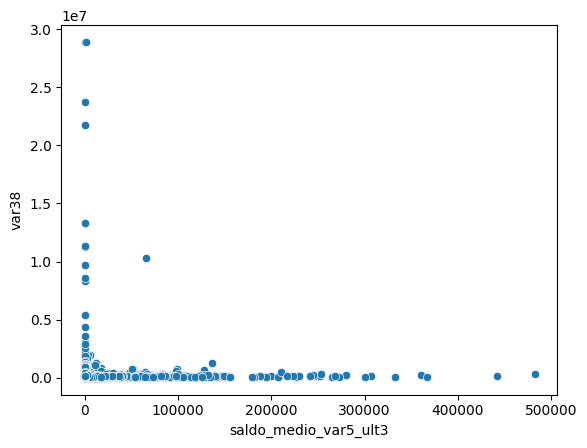

In [ ]:
sns.scatterplot(
    data = test, x='saldo_medio_var5_ult3', y='var38', legend='full'
)

<Axes: xlabel='saldo_medio_var5_ult3', ylabel='saldo_medio_var5_ult1'>

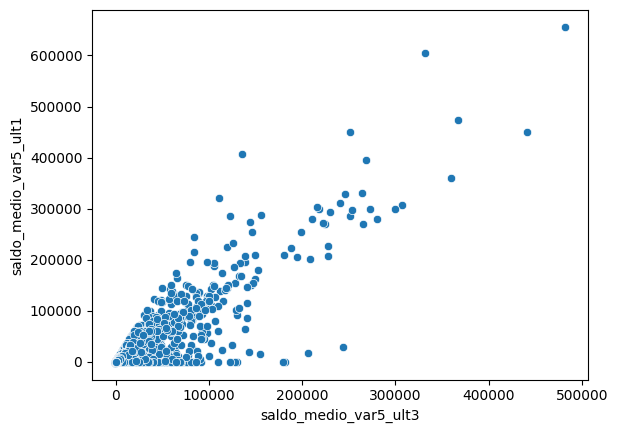

In [ ]:
sns.scatterplot(
    data = test, x='saldo_medio_var5_ult3', y='saldo_medio_var5_ult1', legend='full'
)

<Axes: xlabel='imp_trans_var37_ult1', ylabel='saldo_var30'>

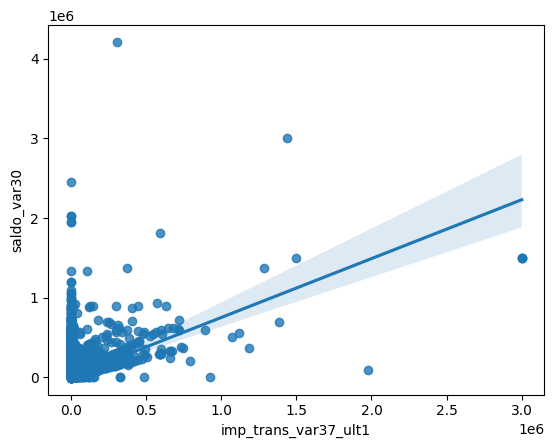

In [ ]:
sns.regplot(
    data=test, x='imp_trans_var37_ult1', y='saldo_var30'
    )

<Axes: xlabel='saldo_var42', ylabel='saldo_var5'>

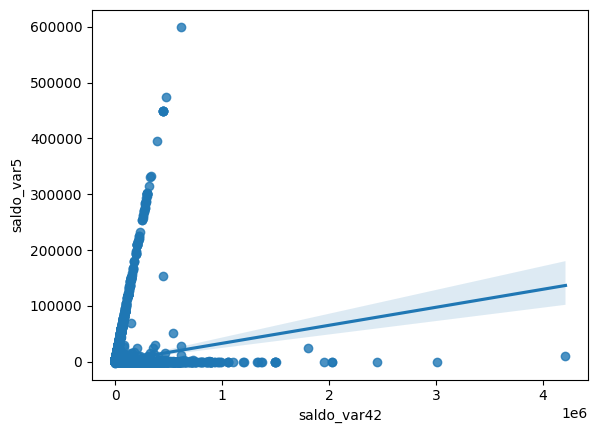

In [ ]:
sns.regplot(
    data=test, x='saldo_var42', y='saldo_var5'
    )